In [22]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from glob import glob
from tqdm import tqdm
from natsort import natsorted
from latex import latexify

latexify(columns = 2)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [23]:
def show_image_grid(images, M, N, title='Title', figsize=8):
    # Assuming 'images' is a numpy array of shape (num_images, height, width, channels)
    if M==1:
        row_size = figsize
        col_size = figsize//4
    elif N==1:
        row_size = figsize//4
        col_size = figsize
    else:
        row_size, col_size = figsize, figsize

    fig, axes = plt.subplots(M, N, figsize=(row_size, col_size))

    if len(images.shape) < 4:
        images = np.expand_dims(images.copy(), axis=0)

    fig.suptitle(title)
    for i in range(M):
        for j in range(N):
            if M==1 and N==1:
                ax = axes
            elif M == 1 or N==1:
                ax = axes[max(i, j)]
            else:
                ax = axes[i, j]
            index = i * N + j
            if index < images.shape[0]:
                ax.imshow(cv2.cvtColor(images[index], cv2.COLOR_BGR2RGB))
            ax.axis('off')
    plt.tight_layout()
    plt.show()

In [24]:
images_i1 = []
for im in tqdm(natsorted(glob('./i2/*.JPG'))):
    images_i1.append(cv2.imread(im))

images_i1 = np.array(images_i1)

100%|██████████| 5/5 [00:00<00:00, 256.71it/s]


In [25]:
images_i1[0].shape

(490, 653, 3)

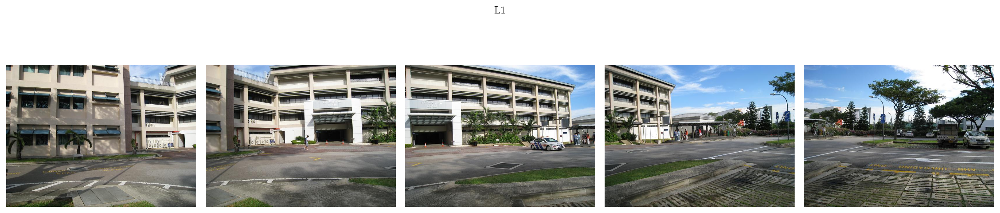

In [26]:
show_image_grid(images_i1, 1, 5, title='L1', figsize = 16)

1447 128


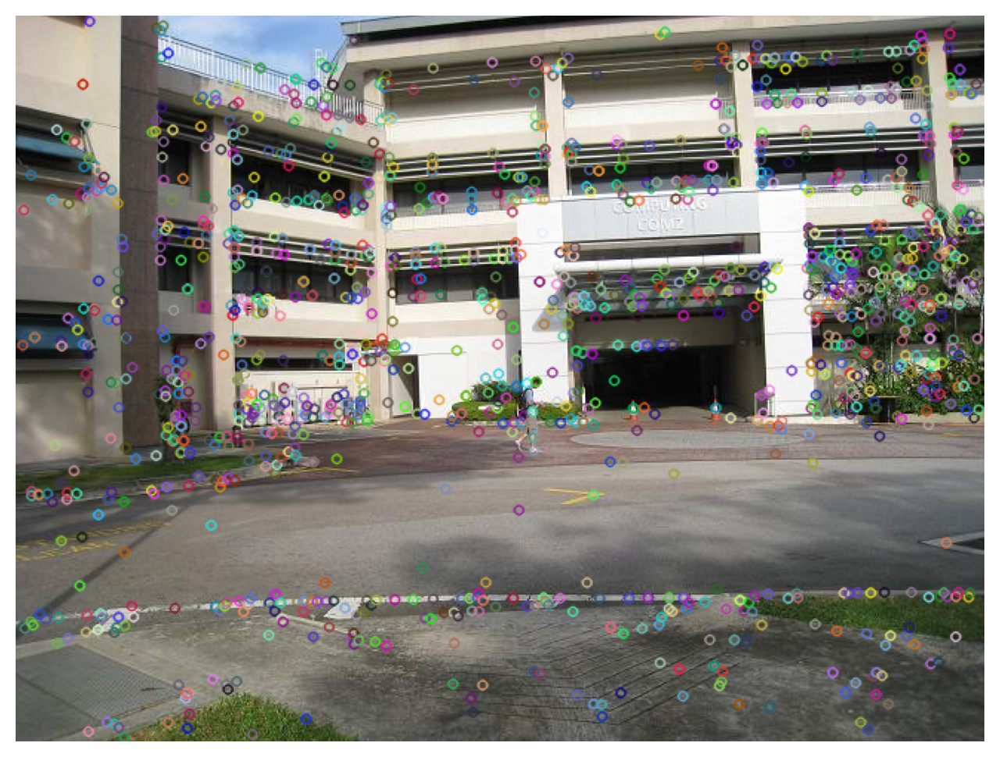

In [27]:
sift = cv2.SIFT_create()
image1 = images_i1[1]
keypoints1, descriptors1 = sift.detectAndCompute(image1, None)
image1_keypoints = cv2.drawKeypoints(image1, keypoints1, None)
print(len(keypoints1), len(descriptors1[0]))

plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(image1_keypoints, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [28]:
(keypoints1[0].pt, keypoints1[0].angle, keypoints1[0].size, keypoints1[0].response, keypoints1[0].octave, keypoints1[0].class_id)

((4.389211177825928, 222.3829803466797),
 280.4223327636719,
 3.0824780464172363,
 0.013584560714662075,
 5637119,
 -1)

In [29]:
descriptors1[0]

array([  2.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,  14.,   0.,   0.,
         0.,   0.,   0.,   0.,  10.,  12.,   0.,   0.,   0.,   0.,   0.,
         2.,  30.,   3.,   0.,   0.,   0.,   7.,  14.,   3.,   7.,  41.,
         2.,   0.,   0.,  69.,  15.,   0.,   7., 154.,   5.,   0.,   0.,
         0.,   0.,   3., 142.,  60.,   1.,   0.,   0.,   0.,   0.,  39.,
       154.,   4.,   0.,   0.,   0.,  12.,  54.,  36.,  31.,  47.,  16.,
         0.,   0., 145.,  38.,   0.,   3., 154.,  95.,   0.,   0.,   2.,
         0.,   0.,  29., 154.,  30.,   0.,   0.,   0.,   1.,  13.,  54.,
        10.,   0.,   0.,   0.,   8.,  41.,  44.,  18.,  19.,   8.,   0.,
         1., 154.,  35.,   0.,   0., 154.,  88.,   0.,   0.,   6.,   1.,
         0.,   0., 154.,  53.,   0.,   0.,   0.,   0.,   1.,   7.,  30.,
        10.,   3.,   4.,  14.,  13.,  14.,   8.], dtype=float32)

# Detect and Match Features using SIFT and FLANN

In [30]:
def detect_and_match_features(img1, img2):
    sift = cv2.SIFT_create()
    
    keypoints1, descriptors1 = sift.detectAndCompute(img1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(img2, None)

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    matches = flann.knnMatch(descriptors1, descriptors2, k=2)
    
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)

    points1 = np.zeros((len(good_matches), 2), dtype=np.float32)
    points2 = np.zeros((len(good_matches), 2), dtype=np.float32)
    
    for i, match in enumerate(good_matches):
        points1[i, :] = keypoints1[match.queryIdx].pt
        points2[i, :] = keypoints2[match.trainIdx].pt

    return points1, points2, keypoints1, keypoints2, good_matches

In [31]:
def draw_matches(img1, img2, keypoints1, keypoints2, matches):
    match_img = cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
    plt.title('Feature Matches')
    plt.axis('off')
    plt.show()

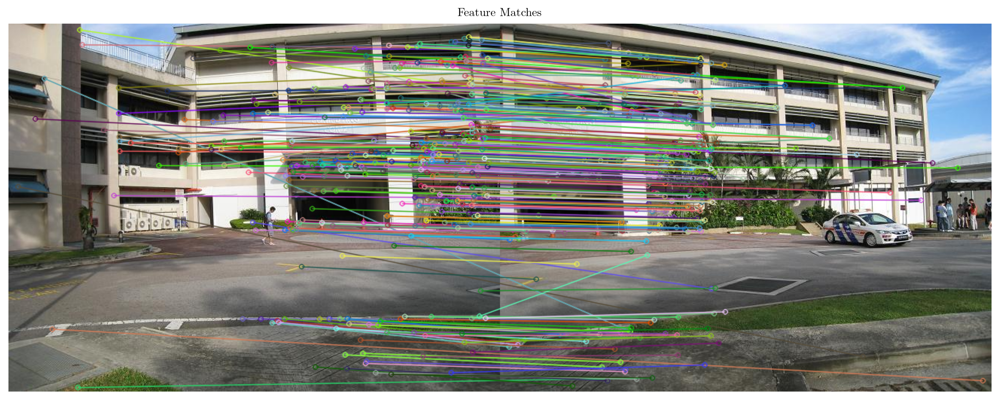

In [32]:
points1, points2, keypoints1, keypoints2, matches = detect_and_match_features(images_i1[1], images_i1[2])
draw_matches(images_i1[1], images_i1[2], keypoints1, keypoints2, matches)

In [33]:
print(points1.shape, points2.shape)
points1[:5], points2[:5]

(343, 2) (343, 2)


(array([[ 12.374431, 217.05806 ],
        [ 35.332634, 126.8363  ],
        [ 47.45632 ,  73.194534],
        [ 47.45632 ,  73.194534],
        [ 57.761147, 406.58264 ]], dtype=float32),
 array([[481.44623, 442.8661 ],
        [574.25836, 185.49269],
        [172.50351, 409.5667 ],
        [172.50351, 409.5667 ],
        [640.98724, 475.05222]], dtype=float32))

In [34]:
homography, mask = cv2.findHomography(points1, points2, cv2.RANSAC, 5.0)
print(homography.shape, mask.shape)
print(homography)

(3, 3) (343, 1)
[[ 1.81098784e+00 -3.59436102e-02 -6.40148075e+02]
 [ 3.07001011e-01  1.60217601e+00 -1.37926702e+02]
 [ 1.24424080e-03 -3.14152743e-05  1.00000000e+00]]


[[[  0.   0.]]

 [[  0. 489.]]

 [[652. 489.]]

 [[652.   0.]]]
[[[-640.1481   -137.9267  ]]

 [[-667.98615   655.6089  ]]

 [[ 291.24368   470.91156 ]]

 [[ 298.47757    34.361977]]]
966 793
[[ 2.64212346e+00 -5.69285781e-02  2.78380704e+01]
 [ 4.78615035e-01  1.59784301e+00 -5.50673224e-06]
 [ 1.24424080e-03 -3.14152743e-05  1.00000000e+00]]


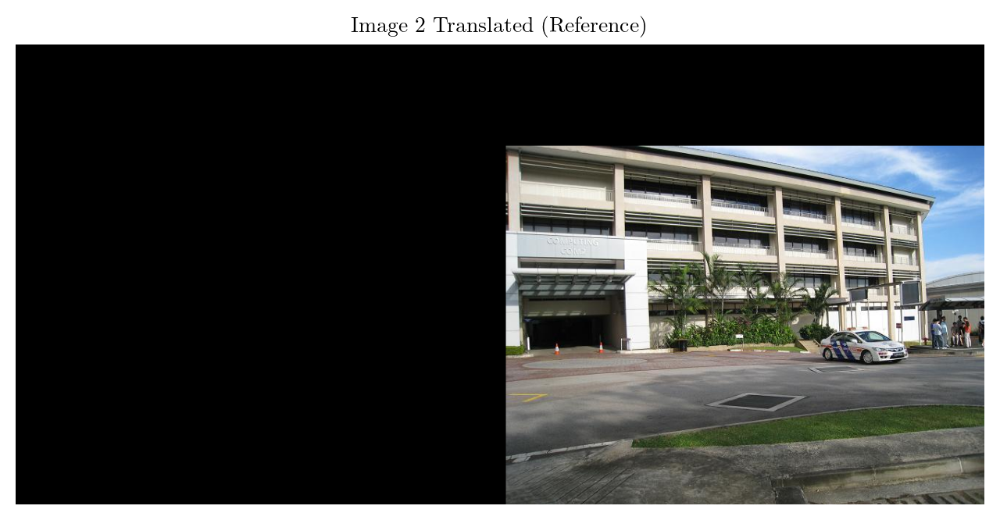

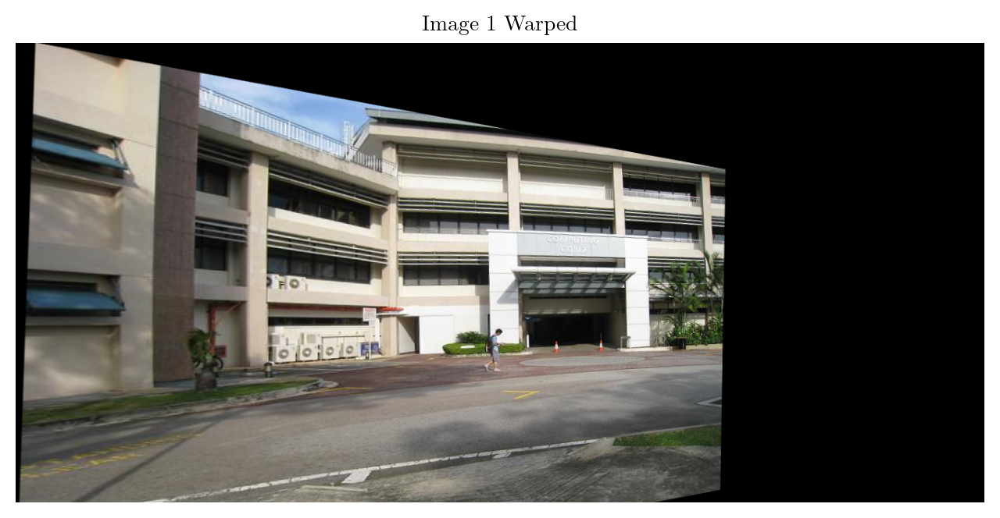

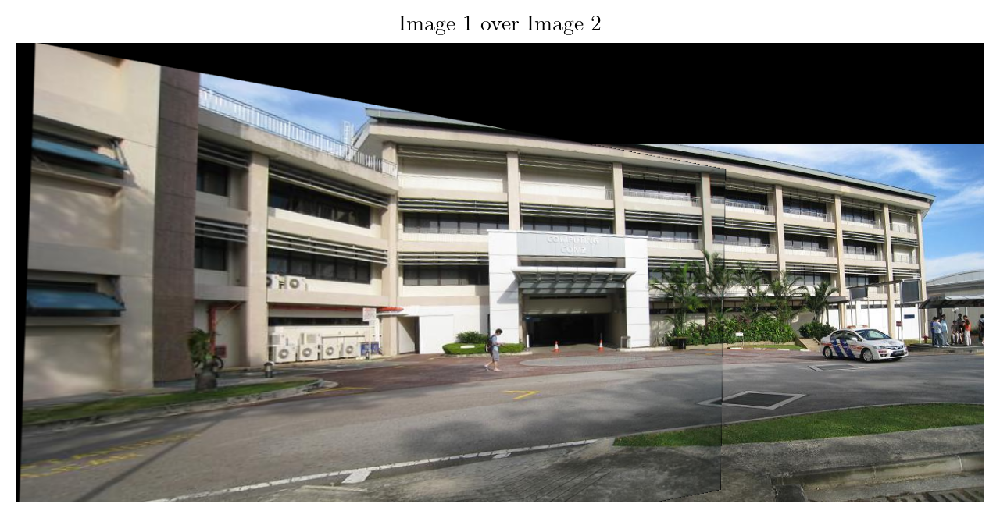

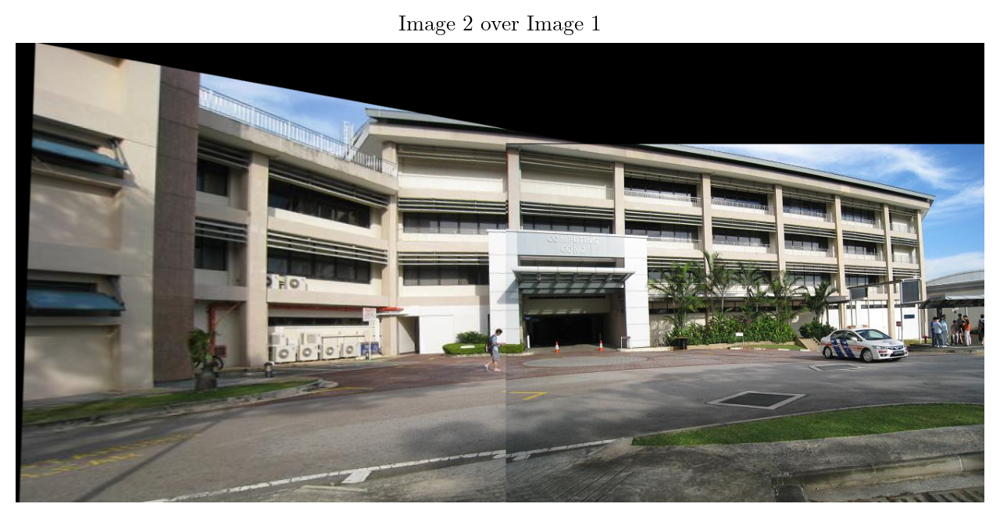

In [35]:
image1, image2 = images_i1[1], images_i1[2]

# find the corners of the destination image using the corners of the source image
h, w = image1.shape[:2]
corners = np.array([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]], dtype=np.float32)
corners = np.expand_dims(corners, axis=1)
dest_corners = cv2.perspectiveTransform(corners, homography)
print(corners)
print(dest_corners)

# now decide the size of the final canvas over which image1 will be warped
min_x, min_y = np.min(dest_corners, axis=0).ravel()
max_x, max_y = np.max(dest_corners, axis=0).ravel()
canvas_width = int(max_x - min_x)
canvas_height = int(max_y - min_y)
print(canvas_width, canvas_height)

# now we need to shift the homography matrix to shift the image to the top left corner
shift_matrix = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
final_homography = np.dot(shift_matrix, homography)
print(final_homography)


# now make the final canvas i.e. width = width of image2 - min_x, height = height of image2 - min_y
final_canvas_width = image2.shape[1] - int(min_x)
final_canvas_height = image2.shape[0] - int(min_y)

# translate image2 using the shift_matrix
image2_warped = cv2.warpPerspective(image2, shift_matrix, (final_canvas_width, final_canvas_height))
image1_warped = cv2.warpPerspective(image1, final_homography, (final_canvas_width, final_canvas_height))


plt.figure(figsize=(8, 8))
plt.title("Image 2 Translated (Reference)")
plt.imshow(cv2.cvtColor(image2_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 1 Warped")
plt.imshow(cv2.cvtColor(image1_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

non_zero_idx = np.where(image1_warped != 0)
final_final_canvas = image2_warped.copy()
final_final_canvas[non_zero_idx] = image1_warped[non_zero_idx]

non_zero_idx1 = np.where(image2_warped != 0)
final_final_canvas1 = image1_warped.copy()
final_final_canvas1[non_zero_idx1] = image2_warped[non_zero_idx1]

plt.figure(figsize=(8, 8))
plt.title("Image 1 over Image 2")
plt.imshow(cv2.cvtColor(final_final_canvas, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 2 over Image 1")
plt.imshow(cv2.cvtColor(final_final_canvas1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Homography Estimation using RANSAC

In [16]:
def compute_homography(pts1, pts2):
    A = []
    for i in range(len(pts1)):
        x, y = pts1[i][0], pts1[i][1]
        x_prime, y_prime = pts2[i][0], pts2[i][1]
        A.append([-x, -y, -1, 0, 0, 0, x * x_prime, y * x_prime, x_prime])
        A.append([0, 0, 0, -x, -y, -1, x * y_prime, y * y_prime, y_prime])
    A = np.array(A)
    _, _, Vt = np.linalg.svd(A)
    H = Vt[-1].reshape(3, 3)
    return H / H[2, 2]

def compute_homography_ransac(points1, points2, iterations=1000, threshold=5.0):
    max_inliers = []
    points1_h = np.hstack([points1, np.ones((points1.shape[0], 1))])
    points2_h = np.hstack([points2, np.ones((points2.shape[0], 1))])

    for _ in range(iterations):
        idxs = np.random.choice(len(points1), 4, replace=False)
        pts1_sample = points1[idxs]
        pts2_sample = points2[idxs]

        H = compute_homography(pts1_sample, pts2_sample)

        projected_points = (H @ points1_h.T).T
        projected_points /= projected_points[:, 2:3]

        distances = np.linalg.norm(points2_h[:, :2] - projected_points[:, :2], axis=1)
        inliers = np.where(distances < threshold)[0]

        if len(inliers) > len(max_inliers):
            max_inliers = inliers
            
    inlier_pts1 = points1[max_inliers]
    inlier_pts2 = points2[max_inliers]
    best_H = compute_homography(inlier_pts1, inlier_pts2)

    return best_H, len(max_inliers)


In [17]:
H, len_max_inliers = compute_homography_ransac(points1, points2)
print(H.shape)
print(H)
print(len_max_inliers)

(3, 3)
[[ 7.26940772e+00  1.20114137e-01 -4.63426073e+03]
 [ 1.37108991e+00  6.87959210e+00 -1.20535649e+03]
 [ 8.33555608e-03  4.12561334e-04  1.00000000e+00]]
87


# Get the Corners after transformation and Homography Estimation Function

In [18]:
def transform_corners(image, H):
    h, w = image.shape[:2]

    corners = np.array([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]], dtype=np.float32)
    corners = np.expand_dims(corners, axis=1)
    
    dest_corners = cv2.perspectiveTransform(corners, H)
    dest_corners = dest_corners.reshape(4, 2)

    min_x, min_y = np.min(dest_corners, axis=0)
    max_x, max_y = np.max(dest_corners, axis=0)

    return dest_corners, min_x, min_y, max_x, max_y


def estimate_homography(image1, image2, useOpenCV = False):
    points1, points2, _, _, _ = detect_and_match_features(image1, image2)
    if useOpenCV:
        H, _ = cv2.findHomography(points1, points2, cv2.RANSAC, 5.0)
    else:
        H, _ = compute_homography_ransac(points1, points2)
    return H

In [19]:
def visualize_homography_corners(images, homographies_wrt_reference, w, h):
    plt.figure(figsize=(15, 5))
    colors = plt.cm.viridis(np.linspace(0, 1, len(images)))

    for i, H in enumerate(homographies_wrt_reference):
        if H is not None:
            corners, _, _, _, _ = transform_corners(images[i], H)            
            plt.scatter(corners[:, 0], corners[:, 1], color=colors[i], label=f'Image {i}')
            plt.gca().add_patch(plt.Polygon(corners, edgecolor=colors[i], facecolor='none', linestyle='-', linewidth=2))

    plt.title('Transformed Corners of Images with Homographies')
    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.xlim(-100, w + 1000)
    plt.ylim(-100, h + 500)
    plt.grid()
    plt.legend()
    plt.show()

In [20]:
H1 = estimate_homography(images_i1[1], images_i1[2], useOpenCV=True)
H2 = estimate_homography(images_i1[1], images_i1[2], useOpenCV=False)
print(H1)
print()
print(H2)

[[ 7.06793301e+00  1.21841519e-01 -4.51068030e+03]
 [ 1.32883472e+00  6.65696653e+00 -1.16708145e+03]
 [ 8.05781160e-03  3.36581439e-04  1.00000000e+00]]

[[ 6.97697762e+00  1.13612217e-01 -4.45564406e+03]
 [ 1.25515223e+00  6.40535933e+00 -1.10794895e+03]
 [ 7.65896532e-03  3.82248889e-04  1.00000000e+00]]


# Stupid Time Waste :(

In [21]:
def panorama_stitcher(images, useOpenCV = False, first_over_last = True):
    """
    Args:
        images (List): List of Images to be stitched together
    """
    
    assert len(images) >= 2, "Number of images should be greater than or equal to 2!"
    
    # suppose the consecutive homography matrices are H01, H12, H23, H34, H45 and the reference images is I2
    # we need H02, H12, H23, H24, H25 (homographies wrt to the reference image)
    # H02 = H01 * H12, H24 = H23 * H34, H25 = H24 * H45
    
    homographies_wrt_reference = [None] * (len(images) - 1)
    
    if len(images) % 2 == 0:
        reference_idx = (len(images) // 2) - 1
    else:
        reference_idx = len(images) // 2
        
    print(reference_idx)
    
    # Homographies of Consecutive Images
    homographies = []
    for i in range(1, reference_idx + 1):
        H = estimate_homography(images[i - 1], images[i], useOpenCV)
        homographies.append(H)
    
    for i in range(reference_idx, len(images) - 1):
        H = estimate_homography(images[i + 1], images[i], useOpenCV)
        homographies.append(H)
    # print(homographies)
    
    homographies_wrt_reference[reference_idx] = homographies[reference_idx]
    if reference_idx >= 1:
        homographies_wrt_reference[reference_idx - 1] = homographies[reference_idx - 1]
    
    # print(homographies_wrt_reference)
    for i in range(reference_idx - 2, -1, -1):
        homographies_wrt_reference[i] = np.dot(homographies[i], homographies_wrt_reference[i + 1])
    
    for i in range(reference_idx + 1, len(images) - 1):
        homographies_wrt_reference[i] = np.dot(homographies_wrt_reference[i - 1], homographies[i])
    
    # homographies_wrt_reference = [H02, H12, H23, H24, H25] same as the indices of images by inserting a None at the reference index
    homographies_wrt_reference.insert(reference_idx, None)
    # now homographies_wrt_reference = [H02, H12, None, H23, H24, H25]
    # print(homographies_wrt_reference)
    
    # computing the transformed corners of all the images
    min_xs, max_xs, min_ys, max_ys = np.inf, -np.inf, np.inf, -np.inf
    for i in range(len(images)):
        if i == reference_idx:
            continue
        dest_corners, min_x, min_y, max_x, max_y = transform_corners(images[i], homographies_wrt_reference[i])
        min_xs = min(min_xs, min_x)
        max_xs = max(max_xs, max_x)
        min_ys = min(min_ys, min_y)
        max_ys = max(max_ys, max_y)
        print(dest_corners)
        print(min_x, min_y, max_x, max_y)
        print("=============================\n")
    print(max_xs, min_xs, max_ys, min_ys)
    
    # final canvas size
    final_canvas_width = int(max_xs - min_xs)
    final_canvas_height = int(max_ys - min_ys)
    print(f"(Width, Height) = ({final_canvas_width}, {final_canvas_height})")
    
    # now we need to shift all the images taking into account the min_x and min_y
    shift_matrix = np.array([[1, 0, -min_xs], [0, 1, -min_ys], [0, 0, 1]])
    
    final_homographies_wrt_reference = []
    for i in range(len(images)):
        if i == reference_idx:
            final_homographies_wrt_reference.append(shift_matrix)
        else:
            final_homographies_wrt_reference.append(np.dot(shift_matrix, homographies_wrt_reference[i]))
    
    visualize_homography_corners(images, final_homographies_wrt_reference, final_canvas_width, final_canvas_height)
    
    warped_images = []
    
    for i in range(len(images)):
        warped_images.append(cv2.warpPerspective(images[i], final_homographies_wrt_reference[i], (final_canvas_width, final_canvas_height)))
    
    # plotting individual warped images
    for i in range(len(warped_images)):
        plt.figure(figsize=(15, 15))
        plt.title(f"Image {i + 1}")
        plt.imshow(cv2.cvtColor(warped_images[i], cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
    
    if first_over_last:
        final_image = warped_images[-1].copy()
        for i in range(len(images) - 2, -1, -1):
            non_zero_indices = np.nonzero(warped_images[i])
            final_image[non_zero_indices] = warped_images[i][non_zero_indices]
    else:
        final_image = np.zeros_like(warped_images[0])
        for i in range(len(images)):
            non_zero_indices = np.nonzero(warped_images[i])
            final_image[non_zero_indices] = warped_images[i][non_zero_indices]
    
    plt.figure(figsize=(15, 15))
    plt.title("Final Image")
    plt.imshow(cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    
    return warped_images

2
[[-713.2667   -81.17893]
 [-801.6849   598.03235]
 [ 185.20064  419.98135]
 [ 198.97252   40.54107]]
-801.6849 -81.17893 198.97252 598.03235

[[-276.6036     -47.570183 ]
 [-272.09622    427.37692  ]
 [ 386.16183    372.88574  ]
 [ 389.94412      1.2368754]]
-276.6036 -47.570183 389.94412 427.37692

[[-124.54264  124.13842]
 [-174.36732  577.3882 ]
 [ 490.31296  532.33386]
 [ 466.44714  138.13867]]
-174.36732 124.13842 490.31296 577.3882

[[-838.59033  186.13773]
 [-997.97473 1003.8636 ]
 [ 163.37494  573.35565]
 [ 123.56032  178.69702]]
-997.97473 178.69702 163.37494 1003.8636

490.31296 -997.97473 1003.8636 -81.17893
(Width, Height) = (1488, 1085)


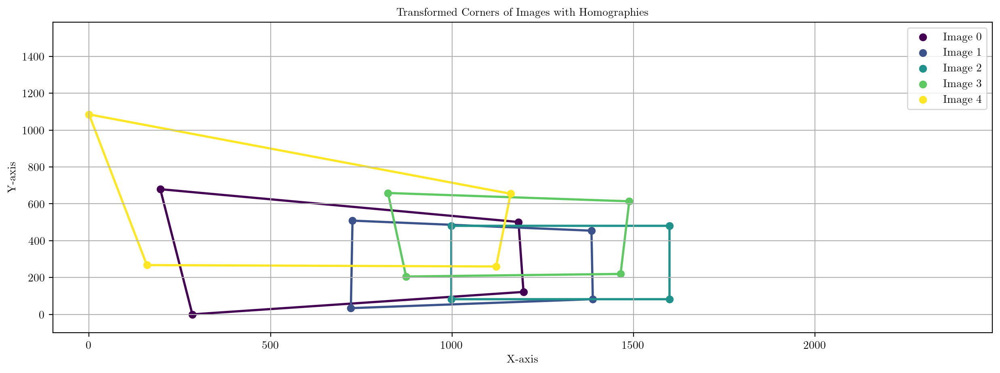

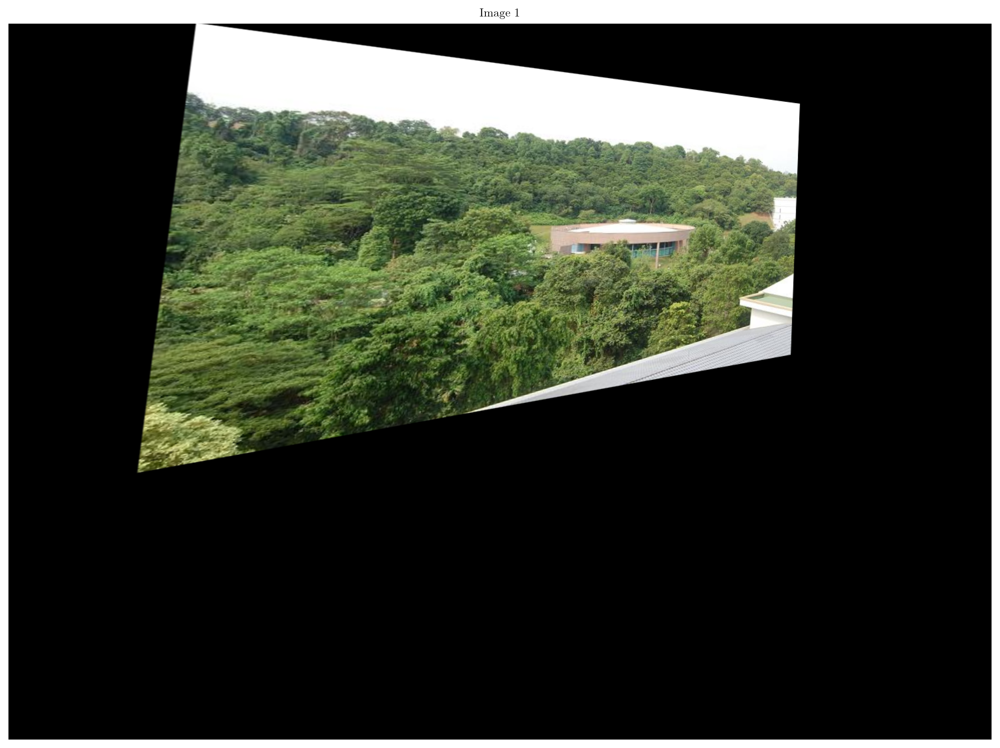

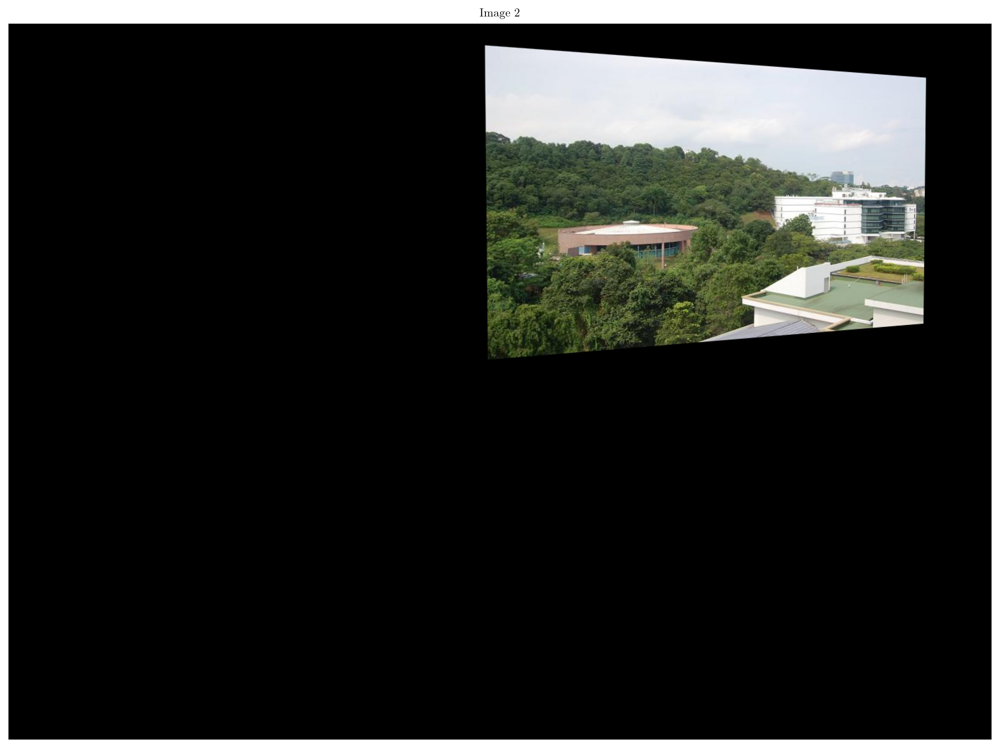

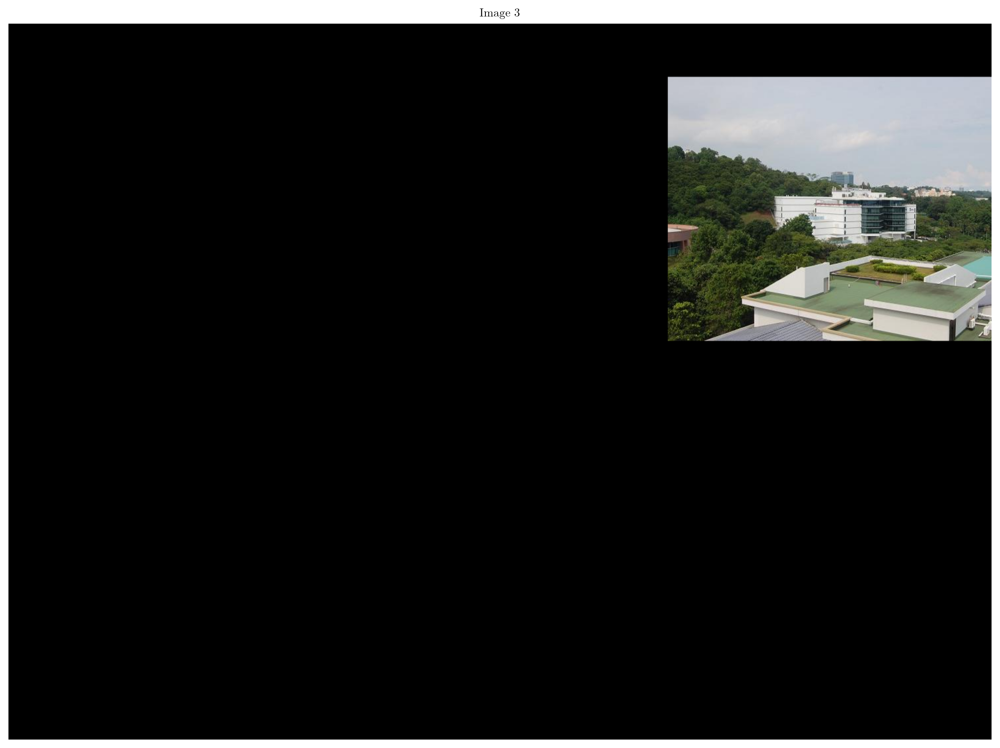

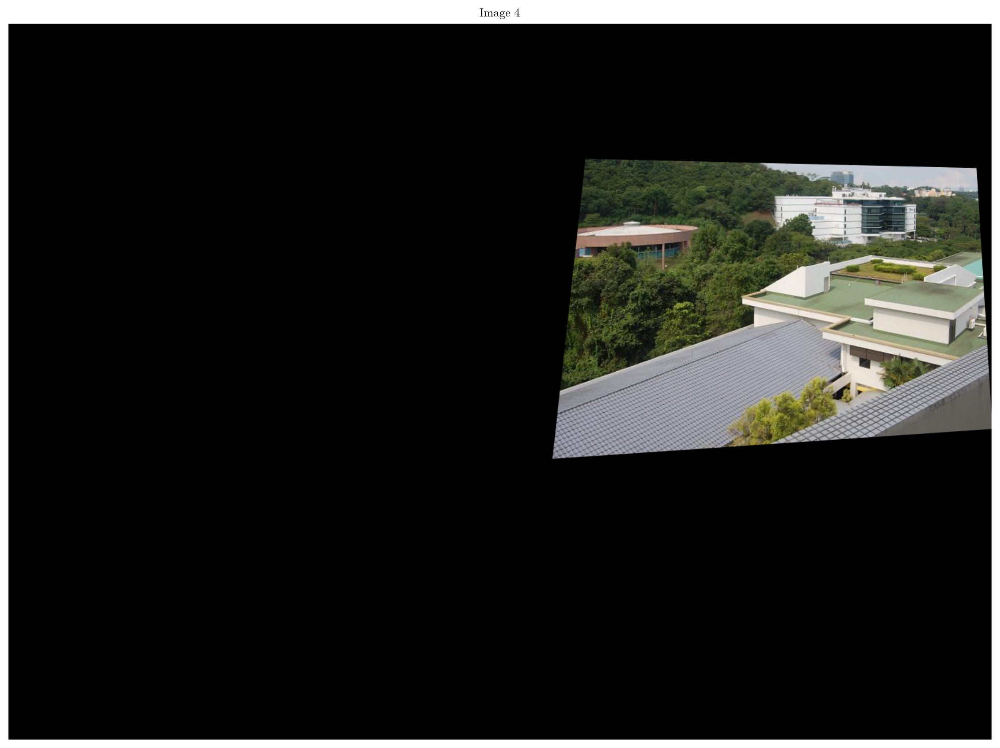

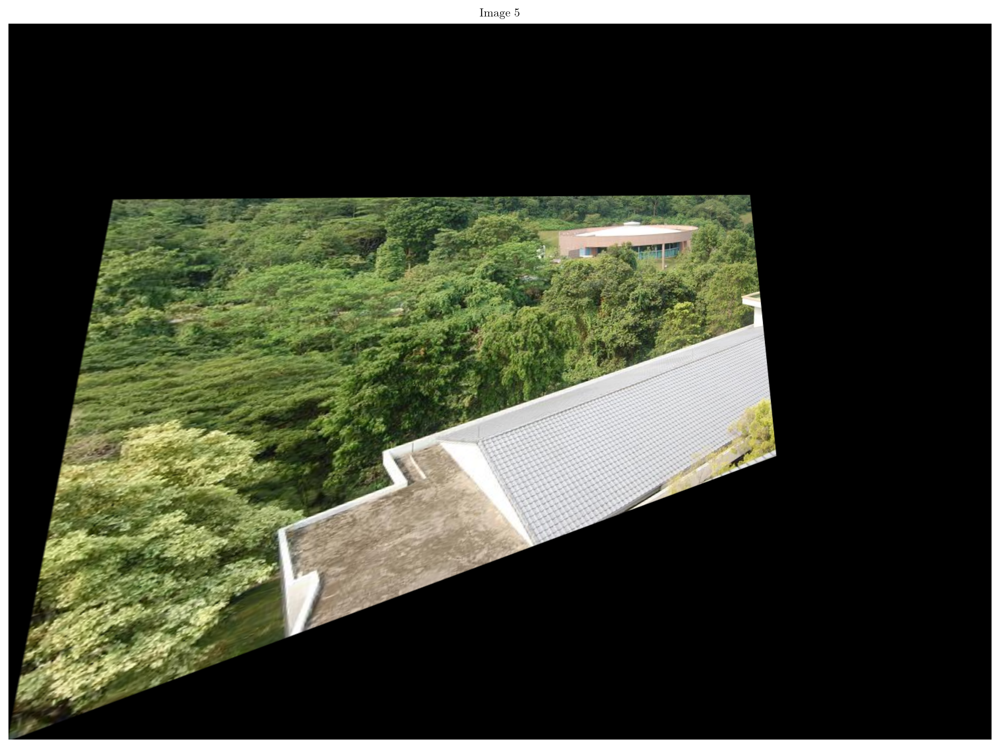

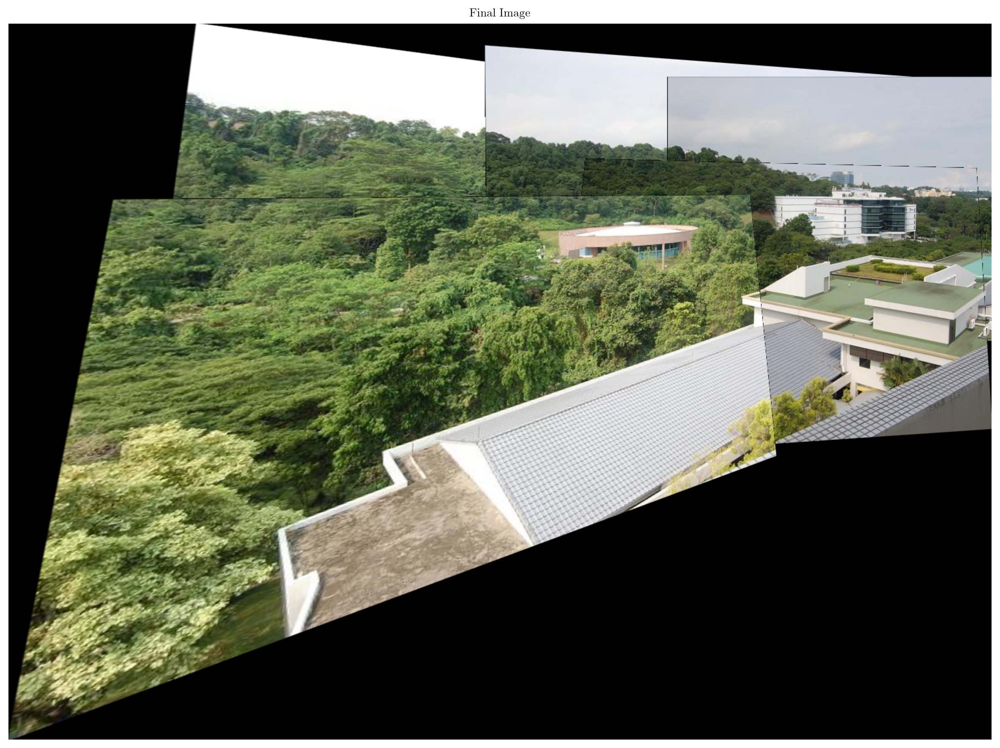

In [22]:
warped_images = panorama_stitcher(images_i1, useOpenCV = False, first_over_last = False)

# Distance Transform

In [79]:
def single_weights_array(size: int) -> np.ndarray:
    """
    Create a 1D weights array.

    Args:
        size: Size of the array

    Returns:
        weights: 1D weights array
    """
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    """
    Create a 2D weights matrix.

    Args:
        shape: Shape of the matrix

    Returns:
        weights: 2D weights matrix
    """
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

# Rightward (Left to Right)

## IMAGE1 and IMAGE2

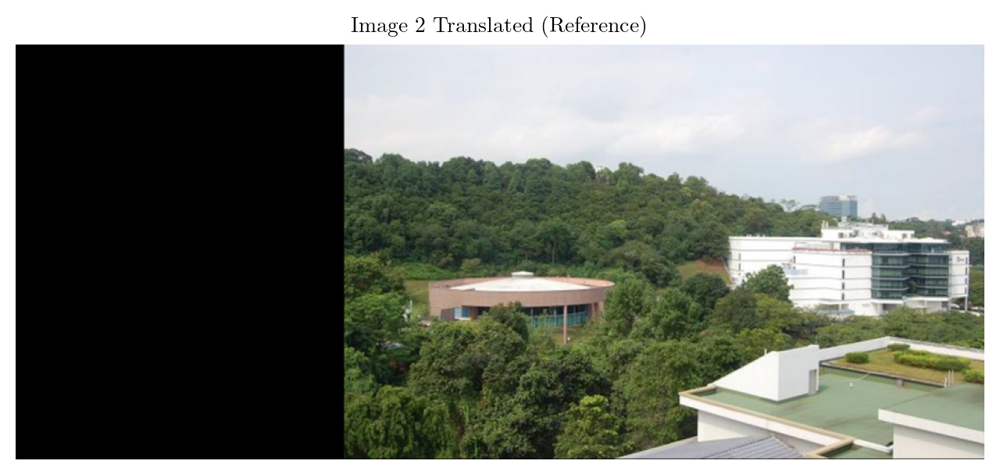

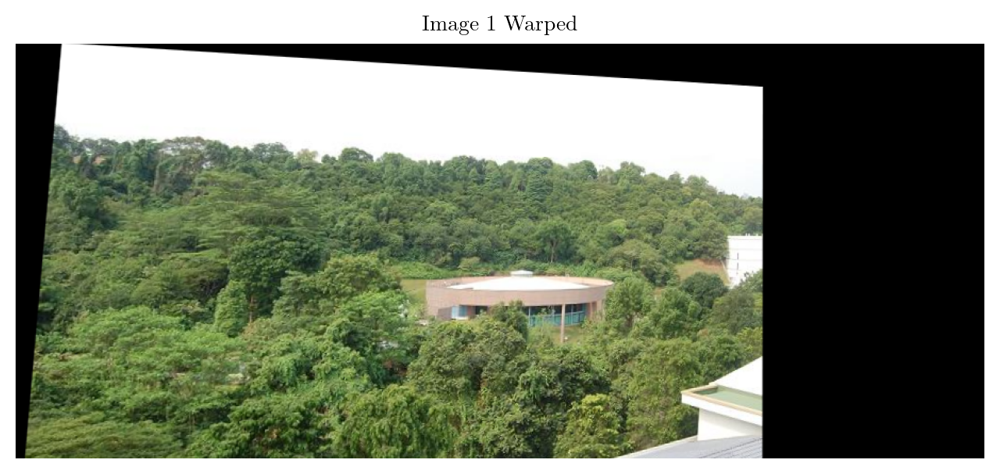

In [80]:
H = estimate_homography(images_i1[0], images_i1[1], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(images_i1[0], H)

shift_matrix12 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])

final_canvas_width = images_i1[1].shape[1] - int(min_x)
final_canvas_height = images_i1[1].shape[0] - int(min_y)

image2_warped = cv2.warpPerspective(images_i1[1], shift_matrix12, (final_canvas_width, final_canvas_height))
image1_warped = cv2.warpPerspective(images_i1[0], shift_matrix12 @ H, (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 2 Translated (Reference)")
plt.imshow(cv2.cvtColor(image2_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 1 Warped")
plt.imshow(cv2.cvtColor(image1_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

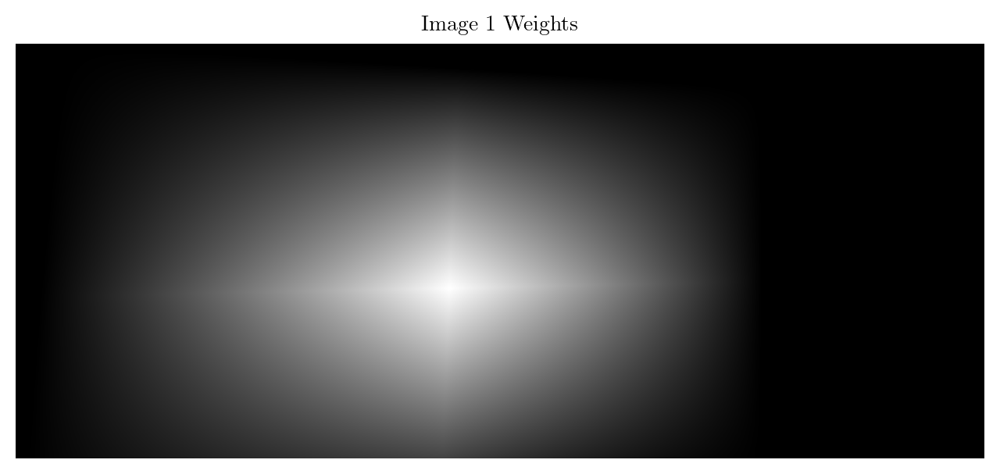

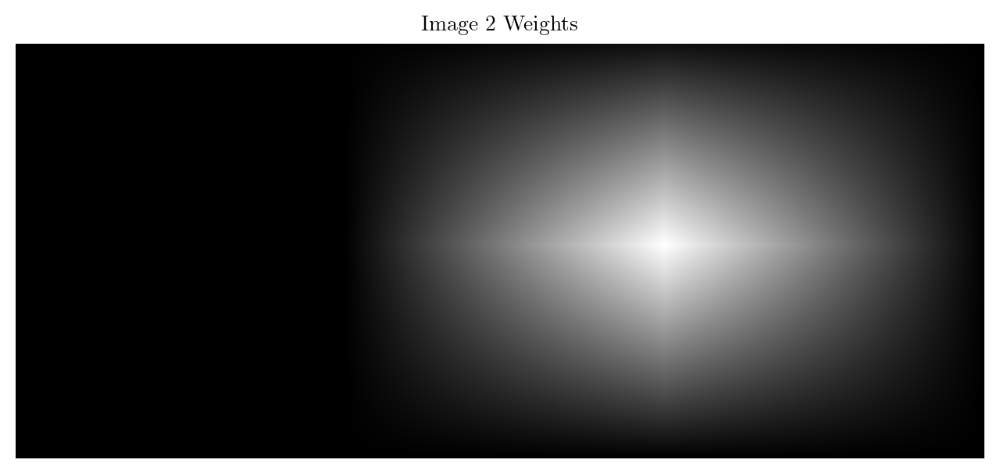

In [81]:
image1, image2 = images_i1[0], images_i1[1]

weight1 = single_weights_matrix(image1.shape[:2])
weight2 = single_weights_matrix(image2.shape[:2])

warped_weight1 = cv2.warpPerspective(weight1, shift_matrix12 @ H, (final_canvas_width, final_canvas_height))
warped_weight2 = cv2.warpPerspective(weight2, shift_matrix12, (final_canvas_width, final_canvas_height))

weight1 = np.repeat(warped_weight1[:, :, np.newaxis], 3, axis=2)
weight2 = np.repeat(warped_weight2[:, :, np.newaxis], 3, axis=2)

plt.figure(figsize=(8, 8))
plt.title("Image 1 Weights")
plt.imshow(weight1, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 2 Weights")
plt.imshow(weight2, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE12

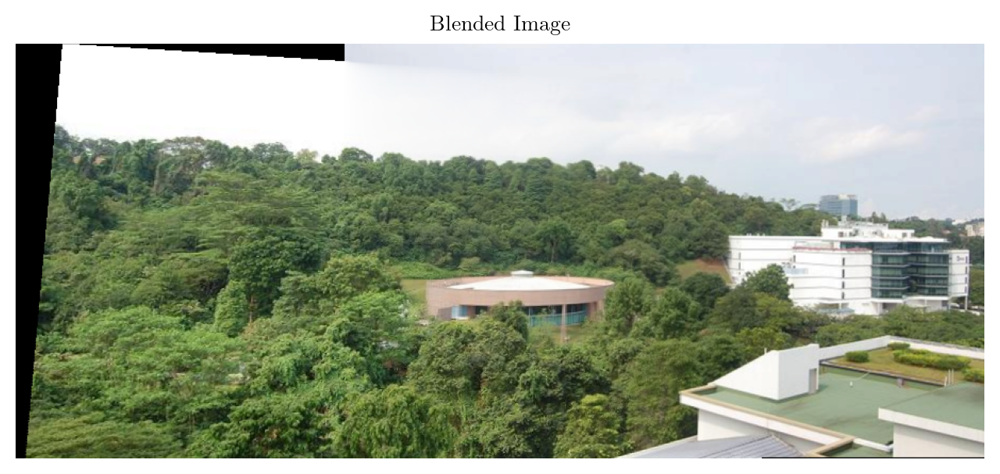

In [82]:
total_weight12 = (weight1 + weight2) / (weight1 + weight2).max()
weight1_normalized = np.divide(weight1, total_weight12, where=total_weight12 != 0)
weight2_normalized = np.divide(weight2, total_weight12, where=total_weight12 != 0)
image1_warped = image1_warped.astype(np.float32)
image2_warped = image2_warped.astype(np.float32)
weight1_normalized = weight1_normalized.astype(np.float32)
weight2_normalized = weight2_normalized.astype(np.float32)

blended_image = (image1_warped * weight1_normalized + image2_warped * weight2_normalized)
blended_image = ((blended_image / blended_image.max()) * 255).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Blended Image")
plt.imshow(cv2.cvtColor(blended_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

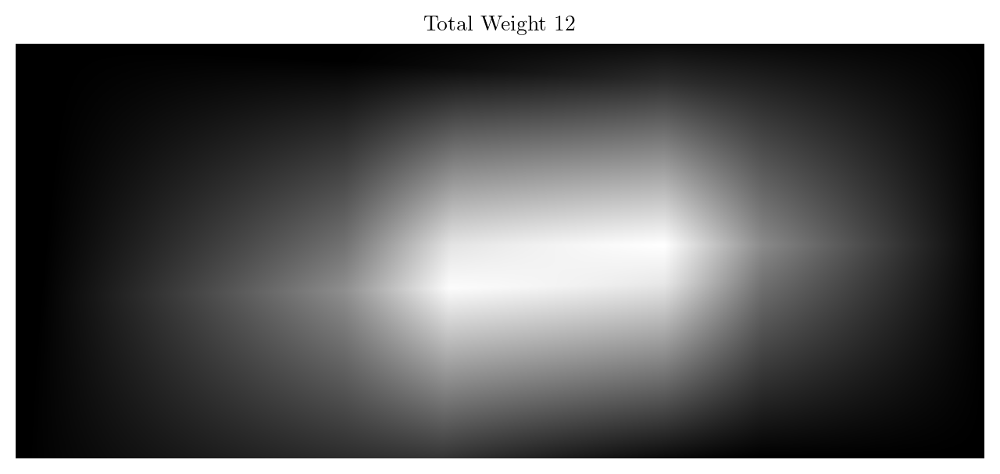

In [83]:
plt.figure(figsize=(8, 8))
plt.title("Total Weight 12")
plt.imshow(total_weight12, cmap='gray')
plt.axis('off')
plt.show()

## IMAGE12 and IMAGE3

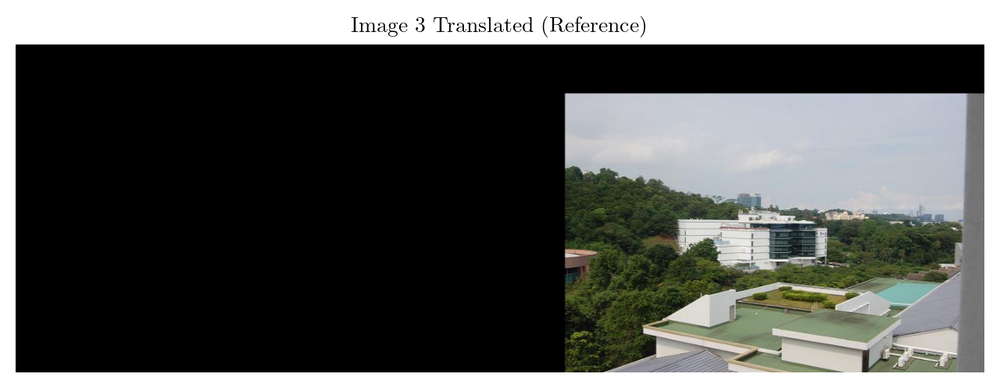

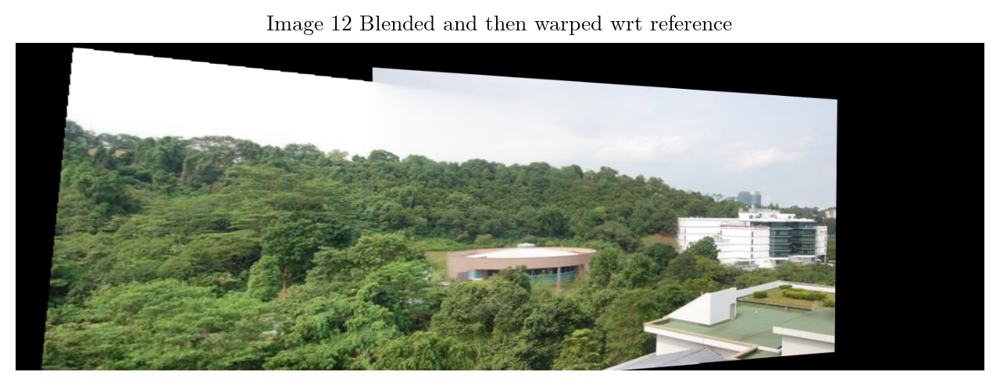

In [84]:
image3 = images_i1[2]
H = estimate_homography(images_i1[1], images_i1[2], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(blended_image, H @ np.linalg.inv(shift_matrix12))

shift_matrix12_3 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])

final_canvas_width = image3.shape[1] - int(min_x)
final_canvas_height = image3.shape[0] - int(min_y)

image3_warped = cv2.warpPerspective(image3, shift_matrix12_3, (final_canvas_width, final_canvas_height))
blended_image_warped = cv2.warpPerspective(blended_image, shift_matrix12_3 @ H @ np.linalg.inv(shift_matrix12), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 3 Translated (Reference)")
plt.imshow(cv2.cvtColor(image3_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 12 Blended and then warped wrt reference")
plt.imshow(cv2.cvtColor(blended_image_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [85]:
corners

array([[-787.70056 ,  -70.02663 ],
       [-775.0638  ,  469.87717 ],
       [ 385.72363 ,  373.47592 ],
       [ 389.35913 ,   11.188237]], dtype=float32)

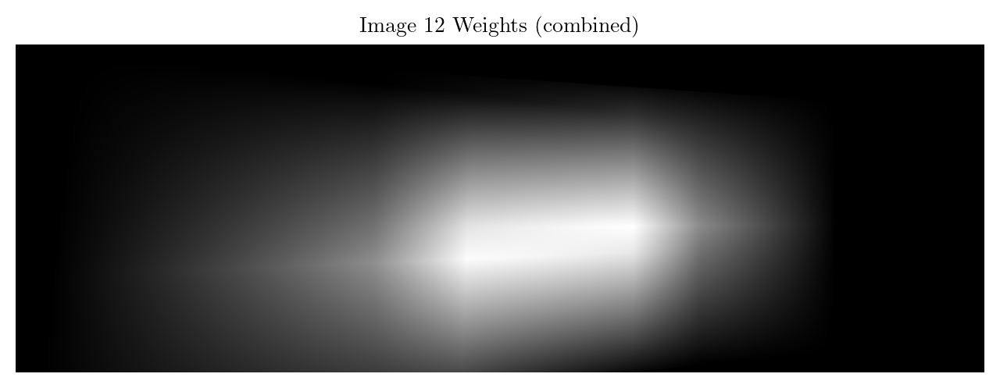

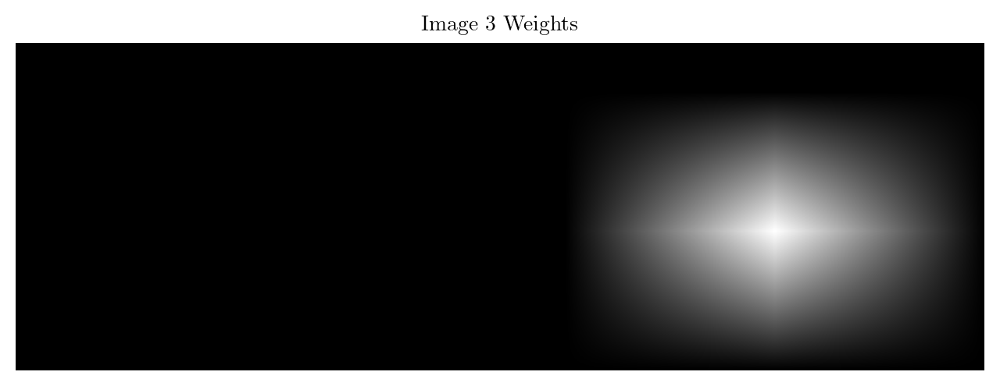

In [86]:
image3 = images_i1[1]

weight3 = single_weights_matrix(image3.shape[:2])

warped_weight3 = cv2.warpPerspective(weight3, shift_matrix12_3, (final_canvas_width, final_canvas_height))
total_weight12 = cv2.warpPerspective(total_weight12, shift_matrix12_3 @ H @ np.linalg.inv(shift_matrix12), (final_canvas_width, final_canvas_height))

weight3 = np.repeat(warped_weight3[:, :, np.newaxis], 3, axis=2)

plt.figure(figsize=(8, 8))
plt.title("Image 12 Weights (combined)")
plt.imshow(total_weight12, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 3 Weights")
plt.imshow(weight3, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE123

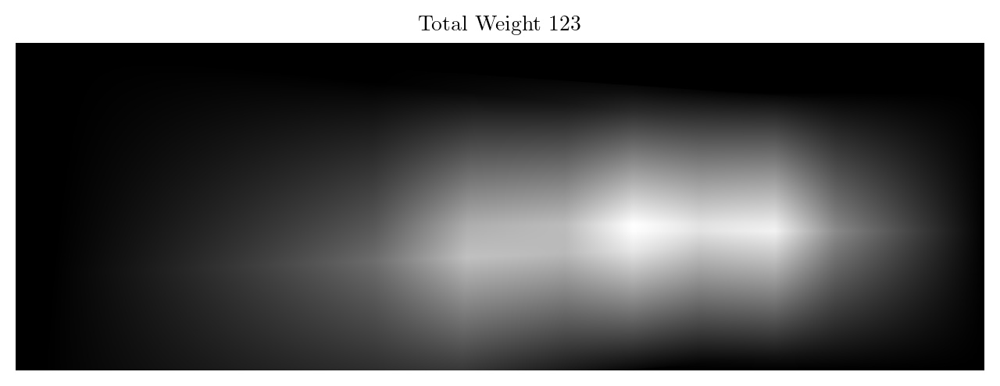

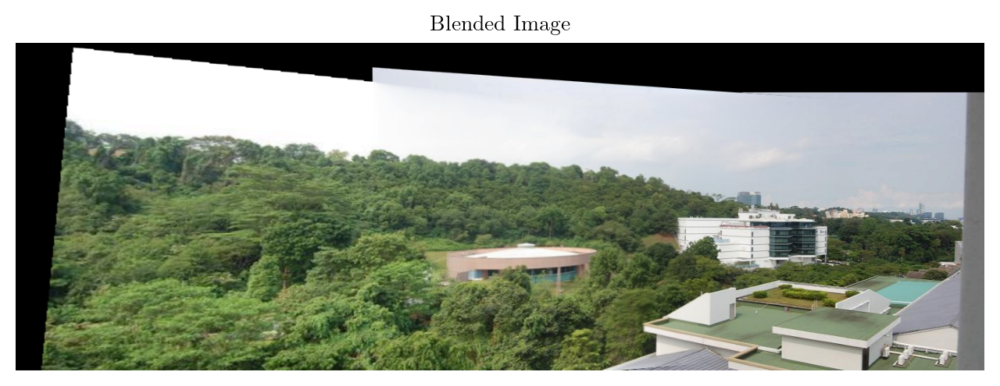

In [87]:
total_weight12_3 = (total_weight12 + weight3)/ (total_weight12 + weight3).max()

weight12_normalized = np.divide(total_weight12, total_weight12_3, where=total_weight12_3 != 0)
weight3_normalized = np.divide(weight3, total_weight12_3, where=total_weight12_3 != 0)

blended_image_warped = blended_image_warped.astype(np.float32)
image3_warped = image3_warped.astype(np.float32)
weight12_normalized = weight12_normalized.astype(np.float32)
weight3_normalized = weight3_normalized.astype(np.float32)

blended_image12_3 = (blended_image_warped * weight12_normalized + image3_warped * weight3_normalized)
blended_image12_3 = (np.clip((blended_image12_3 / blended_image12_3.max()) * 255, 0, 255)).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Total Weight 123")
plt.imshow(total_weight12_3, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image")
plt.imshow(cv2.cvtColor(blended_image12_3, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [65]:
W_final_canvas_width, H_final_canvas_height = final_canvas_width, final_canvas_height 

# BackWard (Right to Left)

## IMAGE6 and IMAGE5

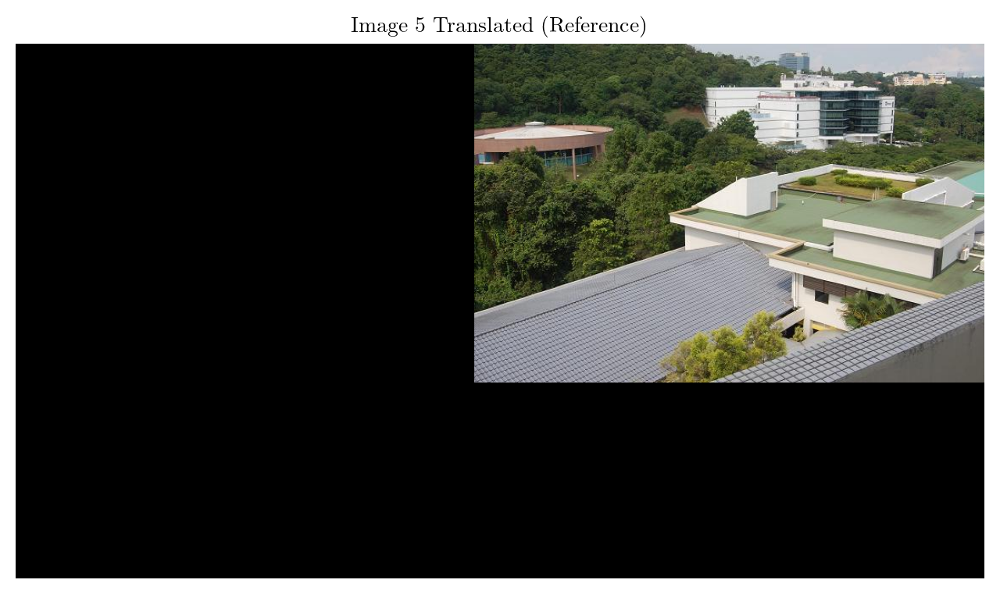

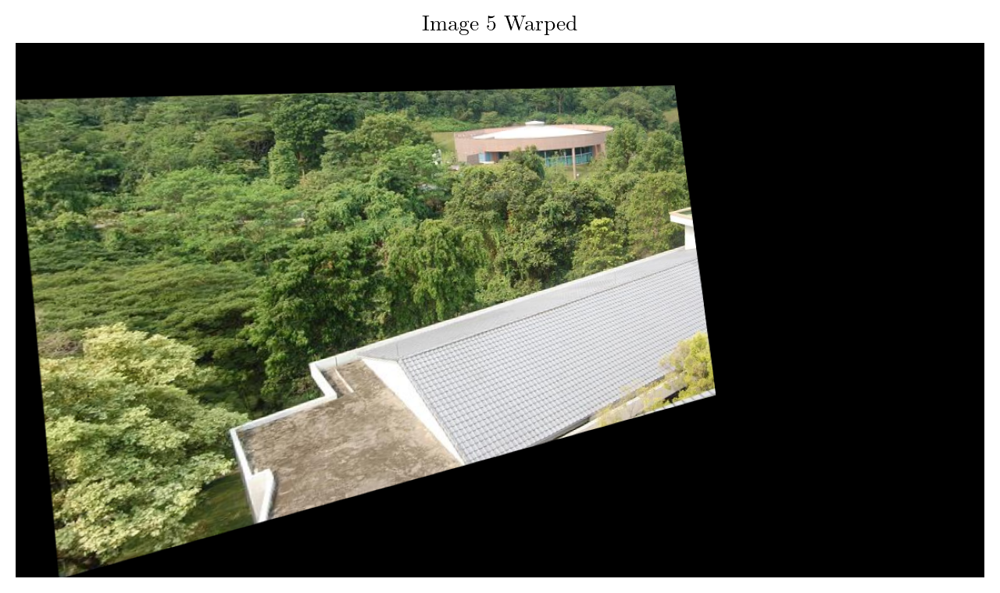

In [90]:
H = estimate_homography(images_i1[4], images_i1[3], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(images_i1[4], H)

shift_x = -min(min_x, 0)
shift_y = -min(min_y, 0)

shift_matrix65 = np.array([[1, 0, shift_x], [0, 1, shift_y], [0, 0, 1]])

final_canvas_width = int(max(max_x, images_i1[3].shape[1]) + shift_x)
final_canvas_height = int(max(max_y, images_i1[3].shape[0]) + shift_y)

image5_warped = cv2.warpPerspective(images_i1[3], shift_matrix65, (final_canvas_width, final_canvas_height))
image6_warped = cv2.warpPerspective(images_i1[4], shift_matrix65 @ H, (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 5 Translated (Reference)")
plt.imshow(cv2.cvtColor(image5_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 5 Warped")
plt.imshow(cv2.cvtColor(image6_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [91]:
corners

array([[-541.0566  ,   67.2239  ],
       [-489.17572 ,  631.02374 ],
       [ 284.21838 ,  414.81183 ],
       [ 235.6003  ,   50.225132]], dtype=float32)

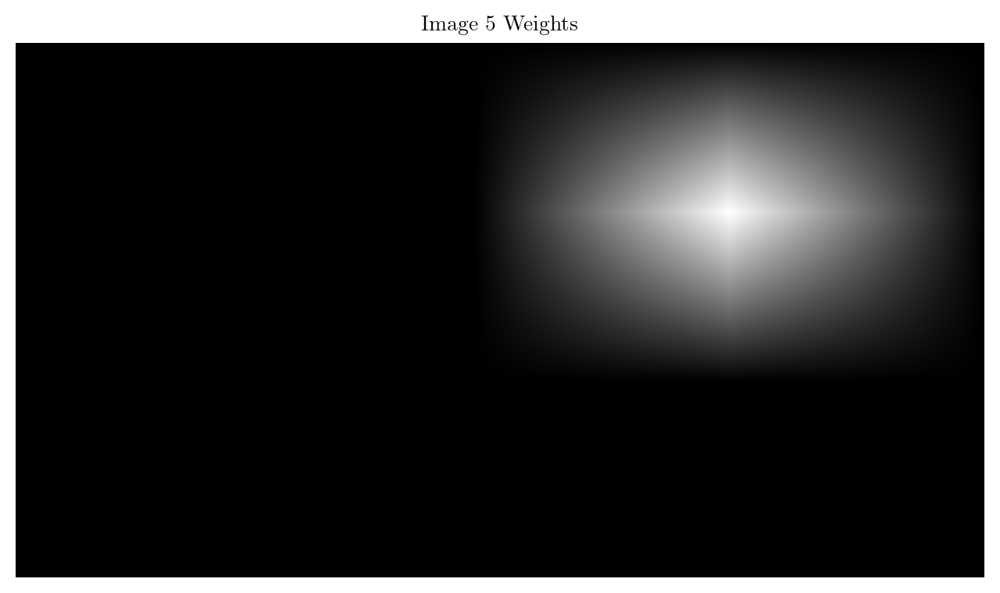

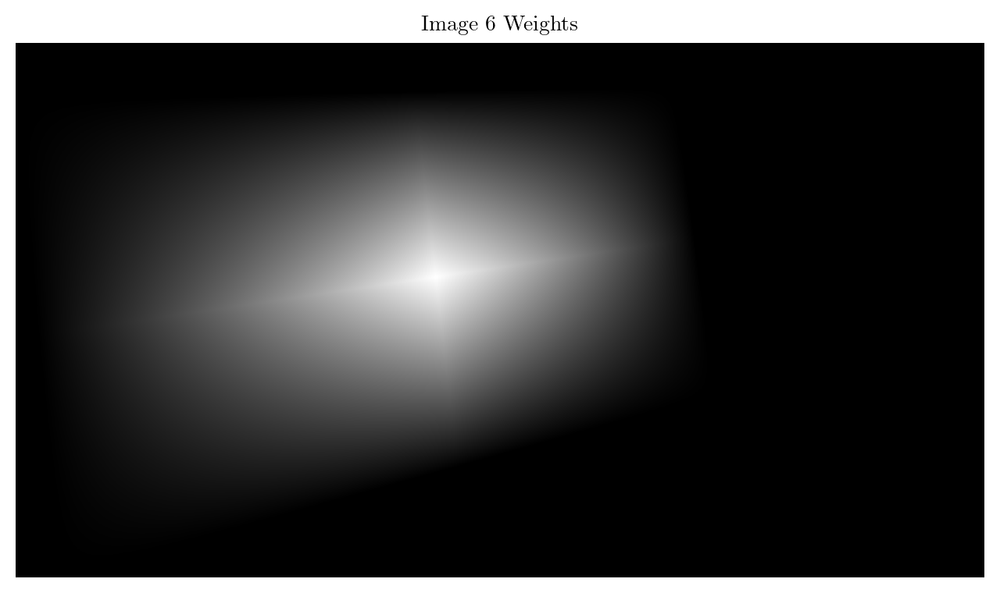

In [92]:
image5, image6 = images_i1[3], images_i1[4]

weight5 = single_weights_matrix(image5.shape[:2])
weight6 = single_weights_matrix(image6.shape[:2])

warped_weight5 = cv2.warpPerspective(weight5, shift_matrix65, (final_canvas_width, final_canvas_height))
warped_weight6 = cv2.warpPerspective(weight6, shift_matrix65 @ H, (final_canvas_width, final_canvas_height))

weight5 = np.repeat(warped_weight5[:, :, np.newaxis], 3, axis=2)
weight6 = np.repeat(warped_weight6[:, :, np.newaxis], 3, axis=2)


plt.figure(figsize=(8, 8))
plt.title("Image 5 Weights")
plt.imshow(weight5, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 6 Weights")
plt.imshow(weight6, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE65

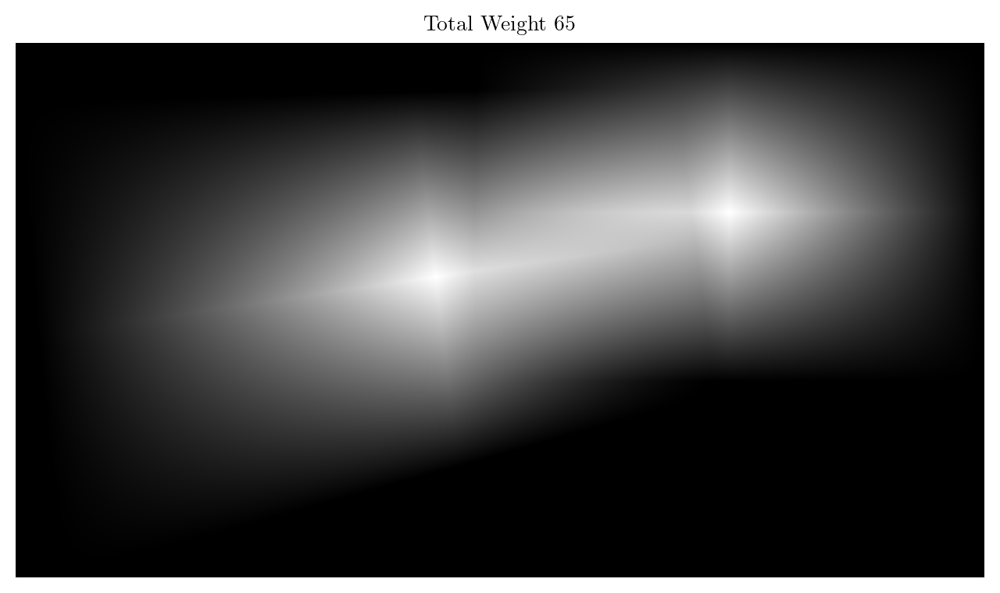

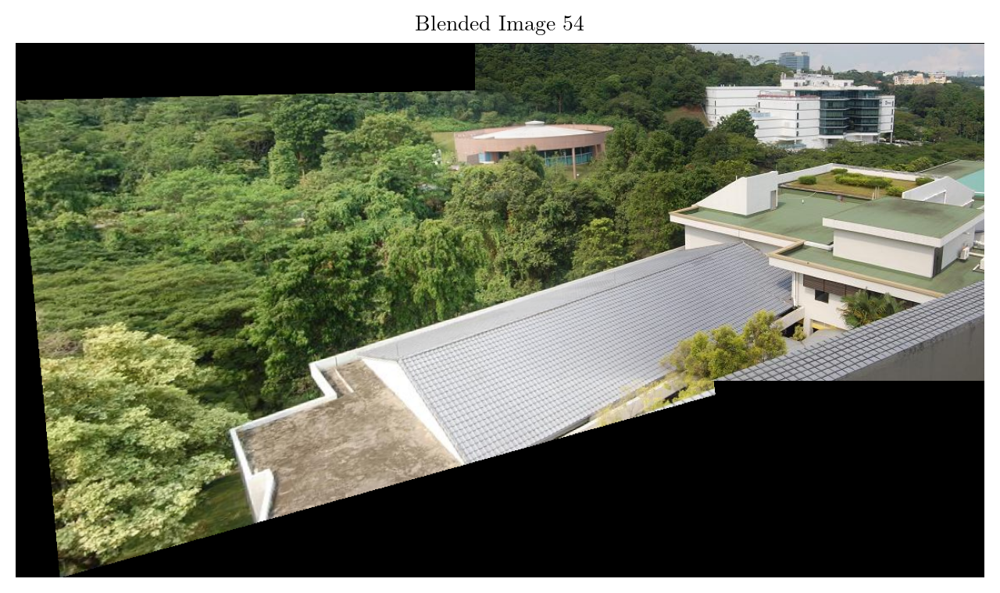

In [93]:
total_weight65 = (weight5 + weight6) / (weight5 + weight6).max()
weight5_normalized = np.divide(weight5, total_weight65, where=total_weight65 != 0)
weight6_normalized = np.divide(weight6, total_weight65, where=total_weight65 != 0)

image5_warped = image5_warped.astype(np.float32)
image6_warped = image6_warped.astype(np.float32)
weight5_normalized = weight5_normalized.astype(np.float32)
weight6_normalized = weight6_normalized.astype(np.float32)

blended_image65 = (image5_warped * weight5_normalized + image6_warped * weight6_normalized)
blended_image65 = (np.clip((blended_image65 / blended_image65.max()) * 255, 0, 255)).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Total Weight 65")
plt.imshow(total_weight65, cmap = "gray")
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image 54")
plt.imshow(cv2.cvtColor(blended_image65, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## IMAGE65 and IMAGE4

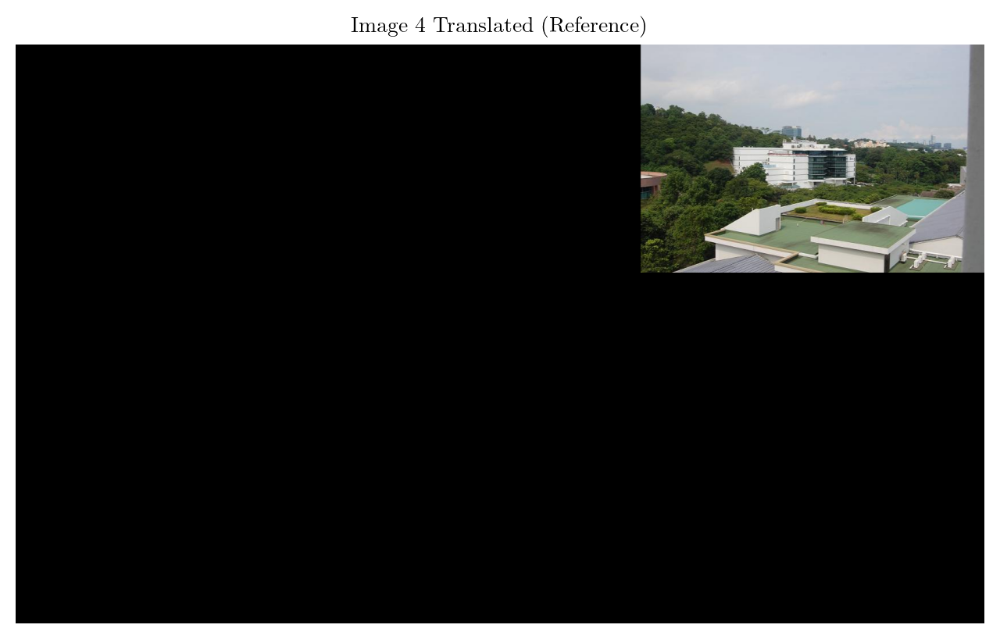

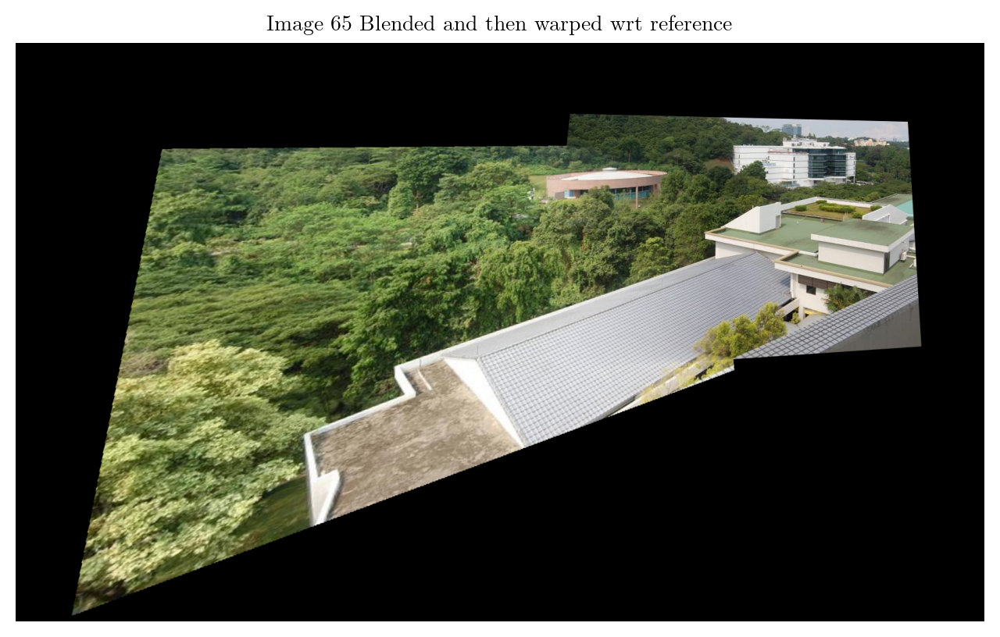

In [94]:
H = estimate_homography(images_i1[3], images_i1[2], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(blended_image65, H @ np.linalg.inv(shift_matrix65))

shift_x = -min(min_x, 0)
shift_y = -min(min_y, 0)

shift_matrix65_4 = np.array([[1, 0, shift_x], [0, 1, shift_y], [0, 0, 1]])

final_canvas_width = int(max(max_x, images_i1[2].shape[1]) + shift_x)
final_canvas_height = int(max(max_y, images_i1[2].shape[0]) + shift_y)

image4_warped = cv2.warpPerspective(images_i1[2], shift_matrix65_4, (final_canvas_width, final_canvas_height))
blended_image65_warped = cv2.warpPerspective(blended_image65, shift_matrix65_4 @ H @ np.linalg.inv(shift_matrix65), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 4 Translated (Reference)")
plt.imshow(cv2.cvtColor(image4_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 65 Blended and then warped wrt reference")
plt.imshow(cv2.cvtColor(blended_image65_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [95]:
corners

array([[ -813.8055 ,   107.77566],
       [-1093.7183 ,  1013.84515],
       [  506.50113,   803.8641 ],
       [  466.3984 ,   138.12567]], dtype=float32)

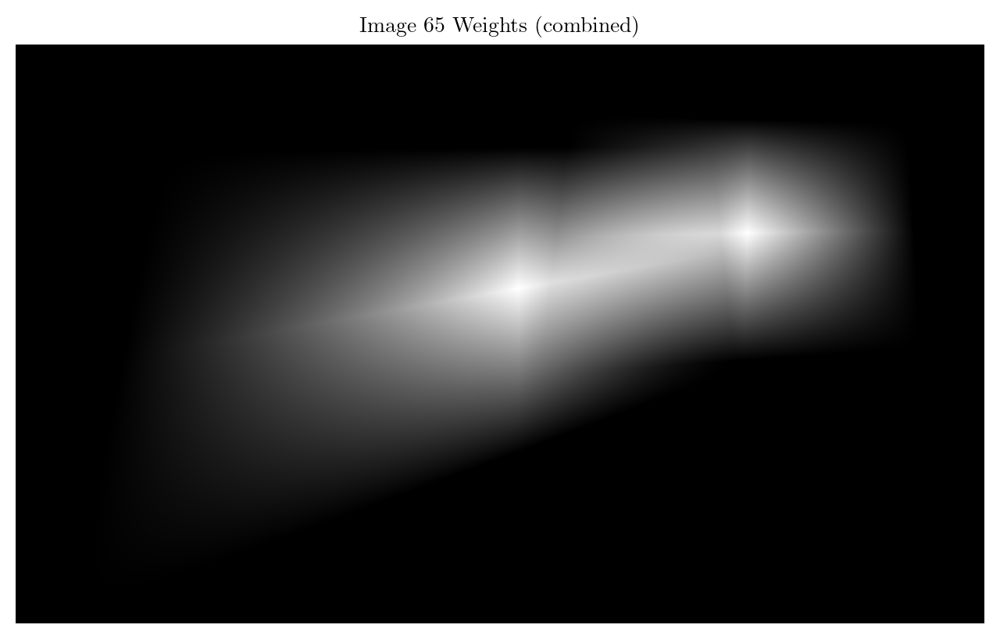

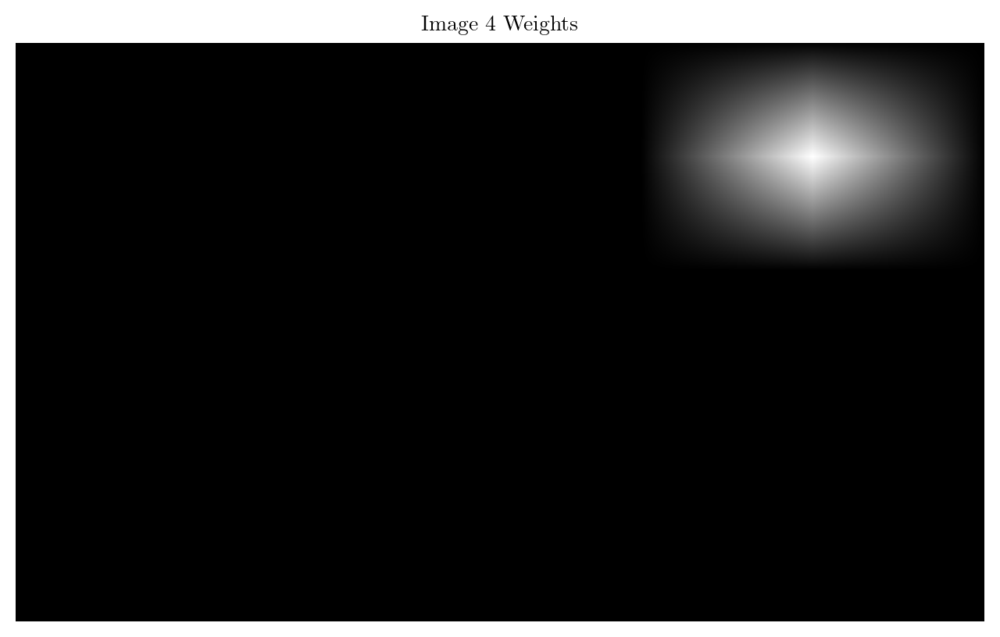

In [96]:
image4 = images_i1[2]

weight4 = single_weights_matrix(image4.shape[:2])

warped_weight4 = cv2.warpPerspective(weight4, shift_matrix65_4, (final_canvas_width, final_canvas_height))

total_weight65 = cv2.warpPerspective(total_weight65, shift_matrix65_4 @ H @ np.linalg.inv(shift_matrix65), (final_canvas_width, final_canvas_height))

weight4 = np.repeat(warped_weight4[:, :, np.newaxis], 3, axis=2)

plt.figure(figsize=(8, 8))
plt.title("Image 65 Weights (combined)")
plt.imshow(total_weight65, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 4 Weights")
plt.imshow(weight4, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE654

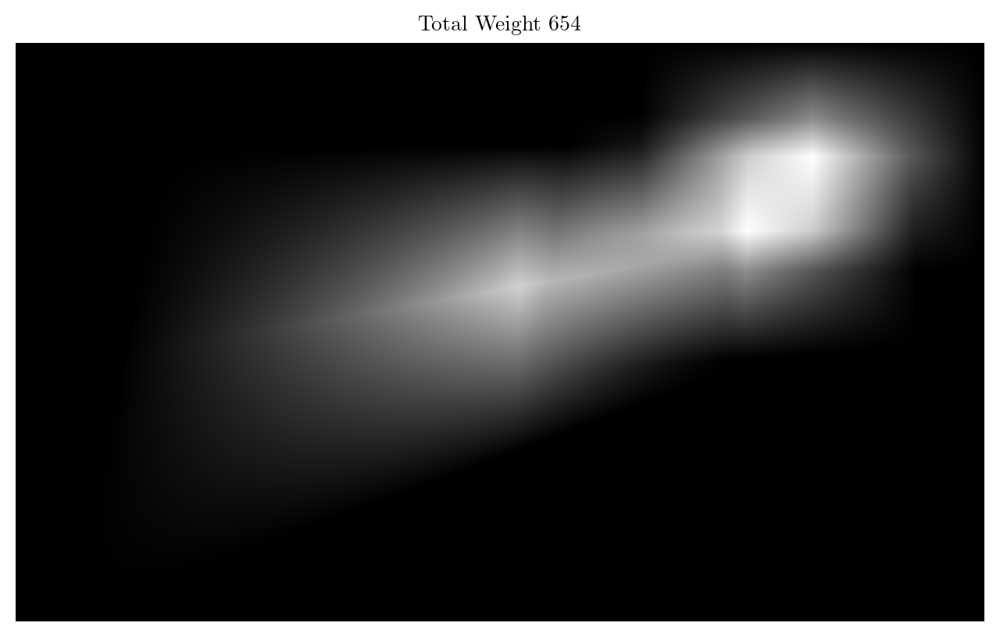

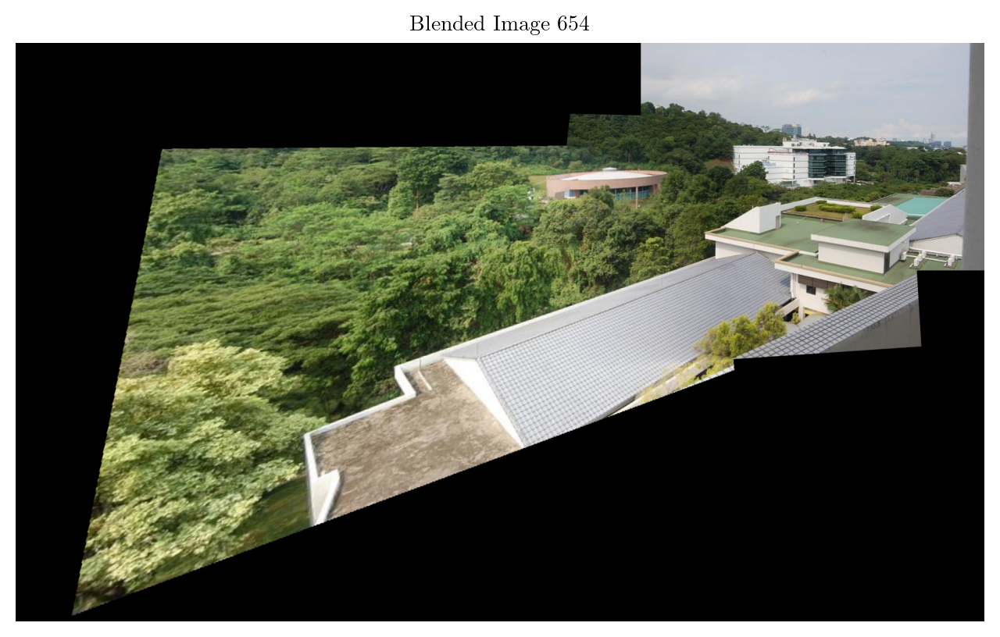

In [97]:
total_weight65_4 = (total_weight65 + weight4)/ (total_weight65 + weight4).max()

weight65_normalized = np.divide(total_weight65, total_weight65_4, where=total_weight65_4 != 0)
weight4_normalized = np.divide(weight4, total_weight65_4, where=total_weight65_4 != 0)

blended_image65_warped = blended_image65_warped.astype(np.float32)
image4_warped = image4_warped.astype(np.float32)
weight65_normalized = weight65_normalized.astype(np.float32)
weight4_normalized = weight4_normalized.astype(np.float32)

blended_image65_4 = (blended_image65_warped * weight65_normalized + image4_warped * weight4_normalized)
blended_image65_4 = (np.clip((blended_image65_4 / blended_image65_4.max()) * 255, 0, 255)).astype(np.uint8)

# blended_image65_4 = np.clip((blended_image65_warped * weight65_normalized + image4_warped * weight4_normalized), 0, 255).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Total Weight 654")
plt.imshow(total_weight65_4, cmap = "gray")
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image 654")
plt.imshow(cv2.cvtColor(blended_image65_4, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Finally to Blend IMAGE123 and IMAGE654

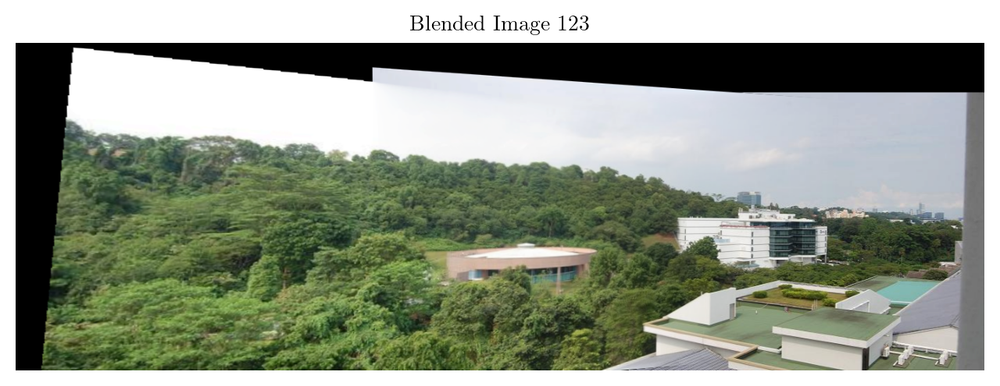

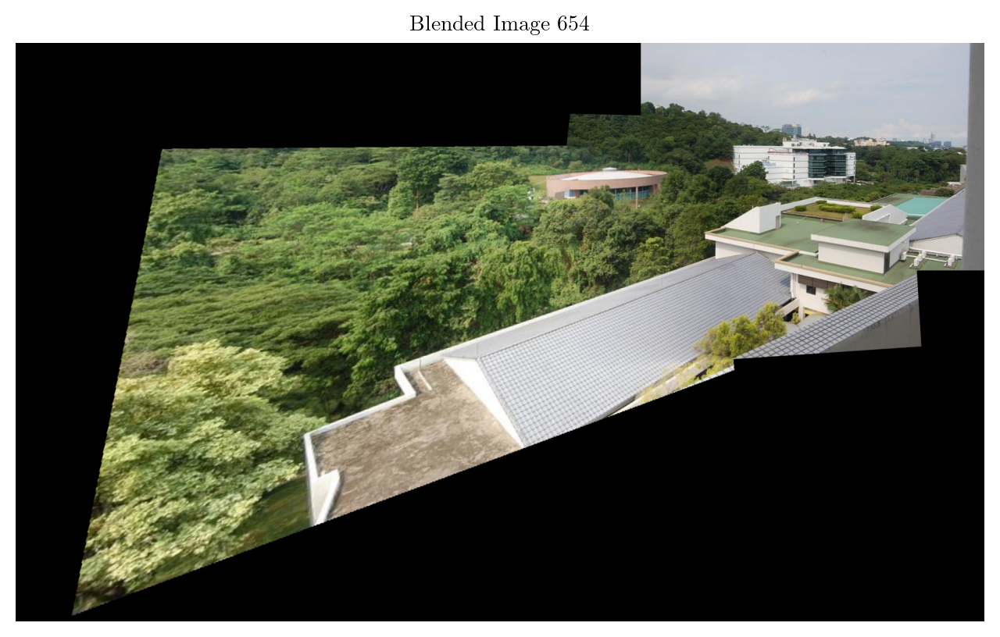

In [98]:
plt.figure(figsize=(8, 8))
plt.title("Blended Image 123")
plt.imshow(cv2.cvtColor(blended_image12_3, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image 654")
plt.imshow(cv2.cvtColor(blended_image65_4, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [99]:
blended_image12_3.shape, blended_image65_4.shape

((470, 1389, 3), (1013, 1695, 3))

In [100]:
H = estimate_homography(images_i1[3], images_i1[2], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(blended_image65_4, H @ np.linalg.inv(shift_matrix65_4))
print(corners)

corners1, min_x1, min_y1, max_x1, max_y1 = transform_corners(blended_image12_3, np.linalg.inv(shift_matrix12_3))
print(corners1)

final_canvas_width = int(max_x - min_x1)
final_canvas_height = int(max(max_y, max_y1) - min(min_y, min_y1))

print(final_canvas_width, final_canvas_height)

[[-1750.673      85.59546]
 [-3034.3455   2278.6863 ]
 [  538.8926   1348.7731 ]
 [  465.82663   138.11794]]
[[-787.70056  -70.02663]
 [-787.70056  398.9734 ]
 [ 600.29944  398.9734 ]
 [ 600.29944  -70.02663]]
1326 2348


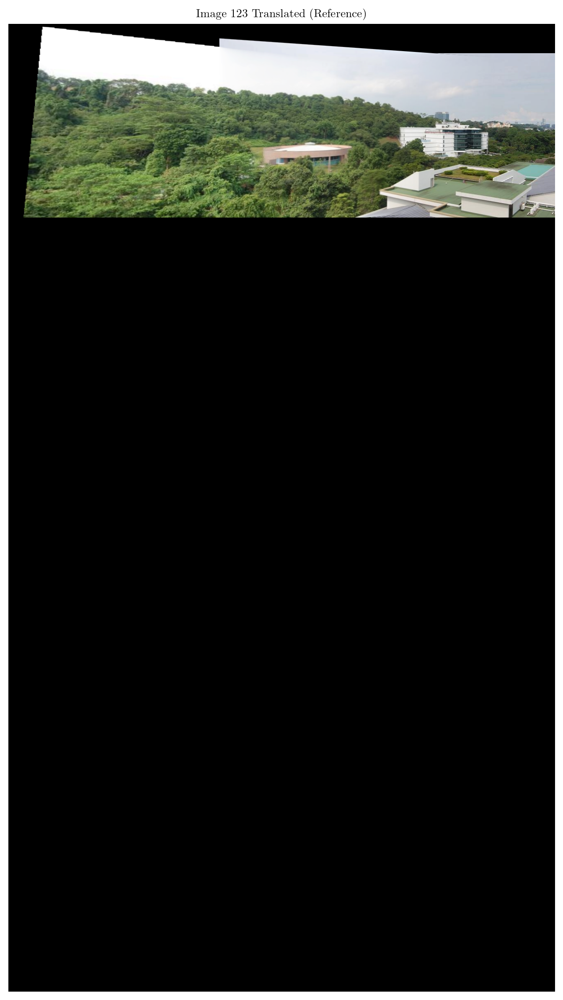

In [101]:
shift_matrix123_654 = np.array([[1, 0, -min_x1], [0, 1, -min(min_y1, min_y)], [0, 0, 1]])
image123_warped = cv2.warpPerspective(blended_image12_3, shift_matrix123_654 @ np.linalg.inv(shift_matrix12_3), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(15, 15))
plt.title("Image 123 Translated (Reference)")
plt.imshow(cv2.cvtColor(image123_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

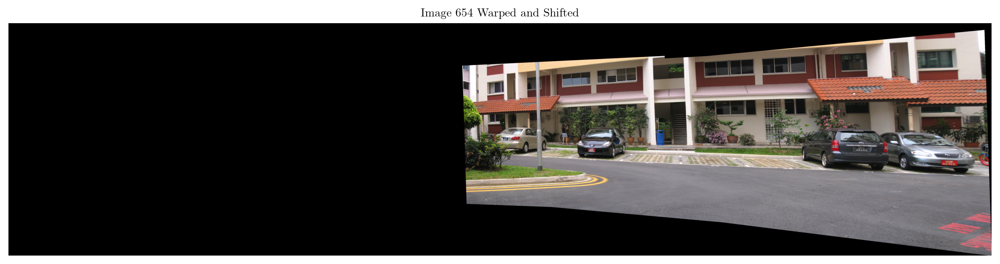

In [78]:
shift_matrix654_123 = np.array([[1, 0, (final_canvas_width - max_x)], [0, 1, -min(min_y1, min_y)], [0, 0, 1]])
image654_warped = cv2.warpPerspective(blended_image65_4, shift_matrix654_123 @ H @ np.linalg.inv(shift_matrix65_4), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(15, 15))
plt.title("Image 654 Warped and Shifted")
plt.imshow(cv2.cvtColor(image654_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

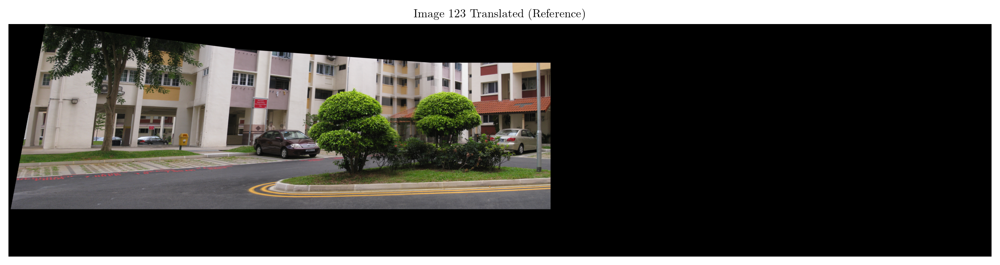

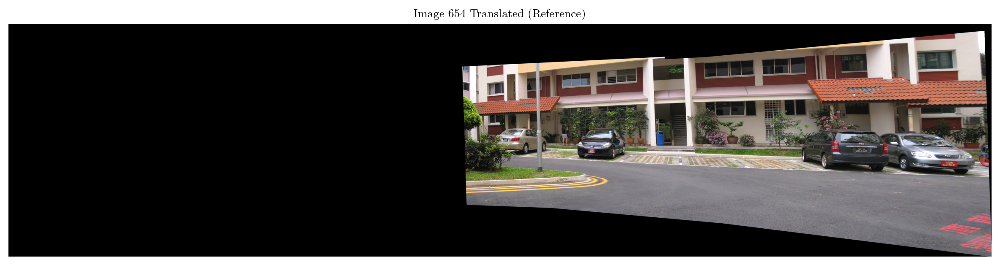

In [79]:
plt.figure(figsize=(15, 15))
plt.title("Image 123 Translated (Reference)")
plt.imshow(cv2.cvtColor(image123_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(15, 15))
plt.title("Image 654 Translated (Reference)")
plt.imshow(cv2.cvtColor(image654_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

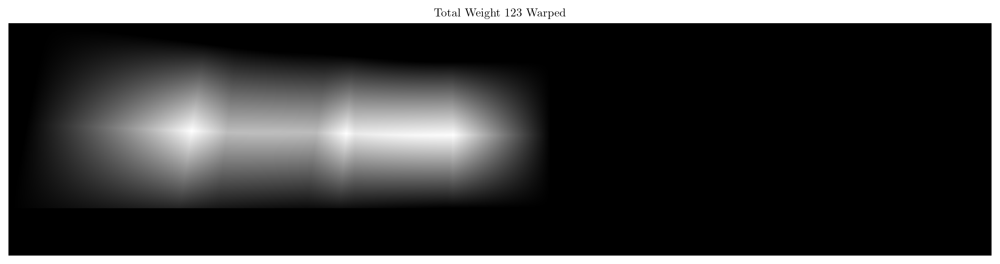

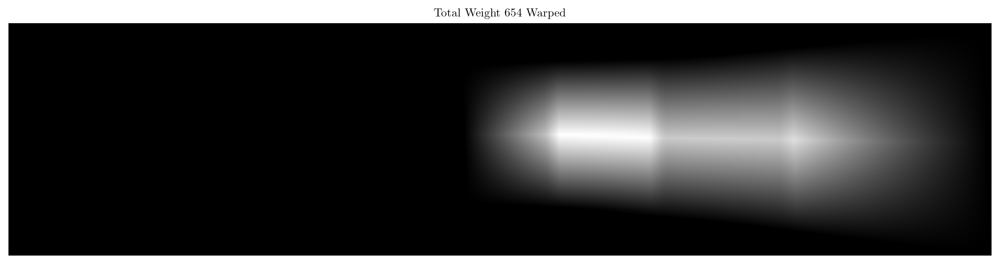

In [80]:
total_weight12_3_warped = cv2.warpPerspective(total_weight12_3, shift_matrix123_654 @ np.linalg.inv(shift_matrix12_3), (final_canvas_width, final_canvas_height))
total_weight654_warped = cv2.warpPerspective(total_weight65_4, shift_matrix654_123 @ H @ np.linalg.inv(shift_matrix65_4), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(15, 15))
plt.title("Total Weight 123 Warped")
plt.imshow(total_weight12_3_warped, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(15, 15))
plt.title("Total Weight 654 Warped")
plt.imshow(total_weight654_warped, cmap='gray')
plt.axis('off')
plt.show()

In [81]:
total_weight123_654 = (total_weight12_3_warped + total_weight654_warped) / (total_weight12_3_warped + total_weight654_warped).max()

weight123_normalized = np.divide(total_weight12_3_warped, total_weight123_654, where=total_weight123_654 != 0)
weight654_normalized = np.divide(total_weight654_warped, total_weight123_654, where=total_weight123_654 != 0)

blended_image123_654 = np.clip((image123_warped * weight123_normalized + image654_warped * weight654_normalized), 0, 255).astype(np.uint8)

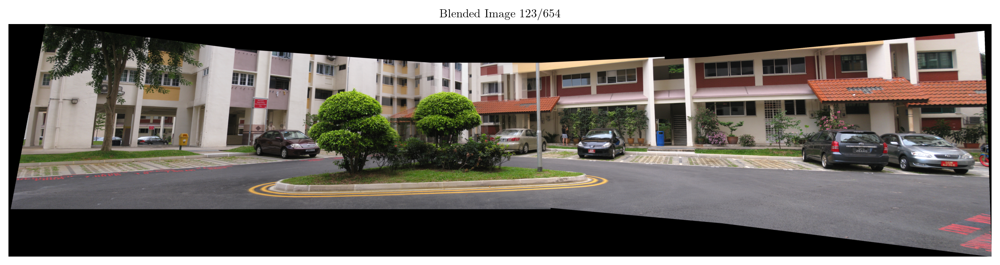

In [82]:
plt.figure(figsize=(15, 15))
plt.title("Blended Image 123/654")
plt.imshow(cv2.cvtColor(blended_image123_654, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()